# Wasserstein GAN for AI Logo

## Download Images from English and Japanese Google

In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [2]:
from fastai.vision import *
from fastai.vision.gan import *

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import dask.dataframe as dd
import multiprocessing
import shutil

### Keywords
- AI 
- AI ML 
- artificial intelligence 
- artificial general intelligence 
- deep learning 
- machine learning 
- computer vision 
- RPA 
- robotic process automation 
- 人工知能 
- 深層学習 

In [2]:
folder = 'AI'
file = 'AI_download_list.csv'

In [3]:
path = Path('data')
dest = path/folder
dest.mkdir(parents=True, exist_ok=True)

In [4]:
path.ls()

[PosixPath('data/AI'),
 PosixPath('data/.ipynb_checkpoints'),
 PosixPath('data/AI_download_list.csv')]

In [6]:
download_images(path/file, dest, max_pics=20000)

In [7]:
# Remove invalid images
verify_images(path/'AI', delete=True, max_size=500)

## Train Classifier to Remove Non-Illustrations

In [12]:
path = Path('data/AI_classifier')

In [13]:
classes = ['0', '1']

In [14]:
np.random.seed(42)
data = ImageDataBunch.from_folder(path, train=".", valid_pct=0.2,
        ds_tfms=get_transforms(), size=224, num_workers=4).normalize(imagenet_stats)

In [16]:
data.classes

['0', '1']

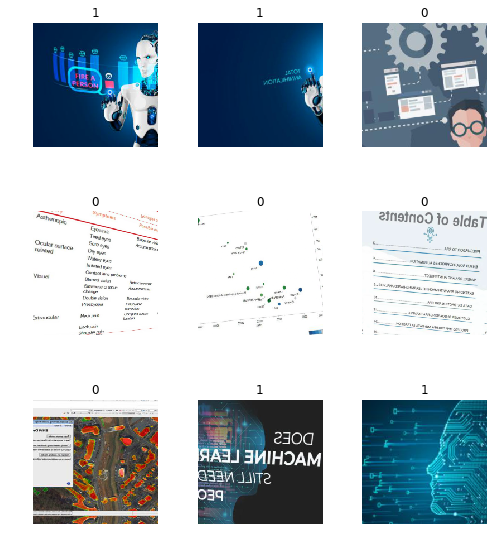

In [17]:
data.show_batch(rows=3, figsize=(7,8))

In [18]:
data.classes, data.c, len(data.train_ds), len(data.valid_ds)

(['0', '1'], 2, 400, 100)

In [19]:
learn = cnn_learner(data, models.resnet34, metrics=error_rate)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth
100%|██████████| 87306240/87306240 [00:05<00:00, 16501648.71it/s]


In [20]:
learn.fit_one_cycle(4)

epoch,train_loss,valid_loss,error_rate,time
0,0.648799,0.426848,0.180000,00:04
1,0.463137,0.442742,0.120000,00:03
2,0.387543,0.439409,0.120000,00:02
3,0.326182,0.442260,0.120000,00:03


In [21]:
learn.save('stage-1')

In [32]:
# learn.load('stage-1')

In [33]:
learn.unfreeze()

In [23]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


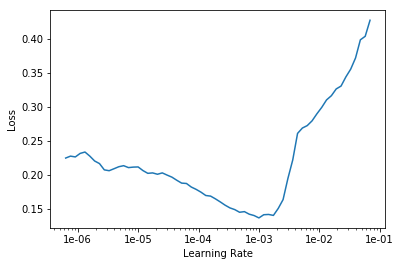

In [25]:
learn.recorder.plot()

In [38]:
learn.fit_one_cycle(5, max_lr=slice(1e-5,1e-4))

epoch,train_loss,valid_loss,error_rate,time
0,0.189561,0.445779,0.120000,00:03
1,0.194104,0.439926,0.120000,00:03
2,0.201331,0.438044,0.120000,00:03
3,0.194307,0.436141,0.120000,00:03
4,0.184092,0.437479,0.120000,00:03


In [39]:
learn.save('stage-2')

In [40]:
interp = ClassificationInterpretation.from_learner(learn)

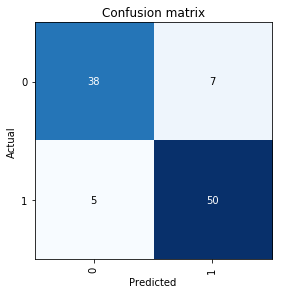

In [41]:
interp.plot_confusion_matrix()

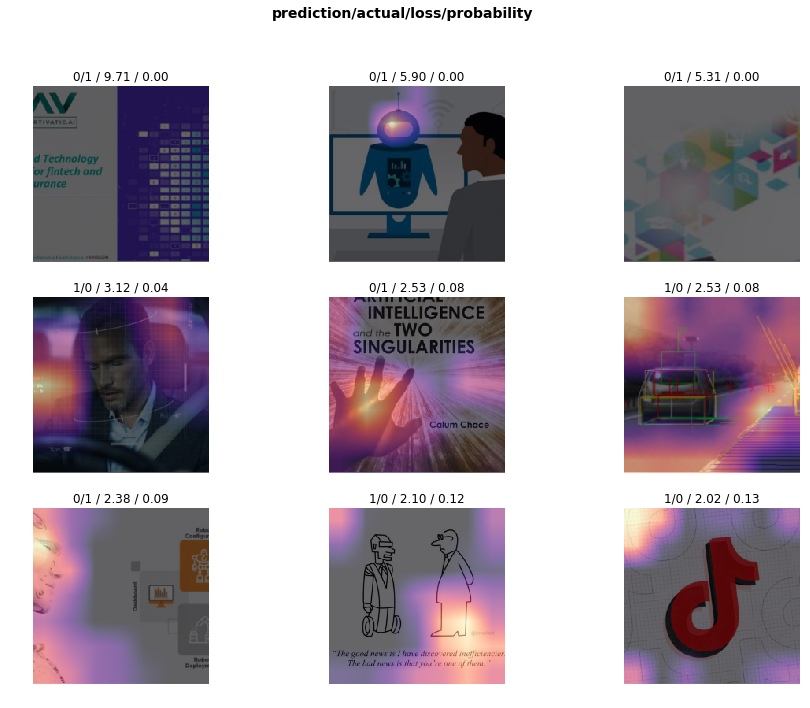

In [42]:
interp.plot_top_losses(9, figsize=(15,11))

In [48]:
path = Path('data/AI')

In [108]:
data_rest = ImageDataBunch.from_folder('data/AI', train=".", valid_pct=0,
        ds_tfms=get_transforms(), size=224, num_workers=4).normalize(imagenet_stats)

In [109]:
len(data_rest.train_ds)

13804

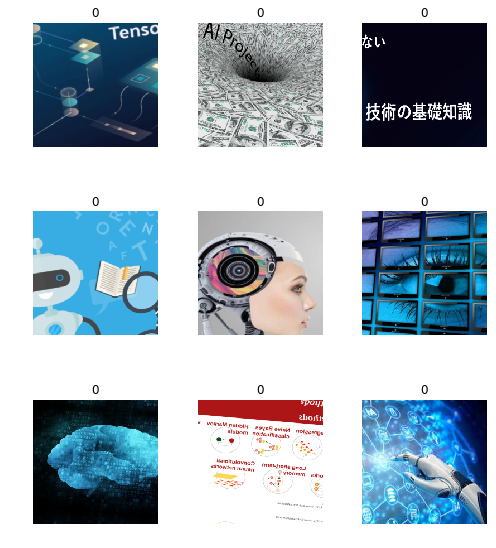

In [93]:
data_rest.show_batch(rows=3, figsize=(7,8))

In [87]:
!mkdir -p data/AI/models
!mkdir -p data/AI/0
!mkdir -p data/AI/1
!cp `ls data/AI/*.* | head -n 1` 1
!mv data/AI/*.* 0
!cp data/AI_classifier/models/*.pth data/AI/models

In [111]:
learn = cnn_learner(data_rest, models.resnet34, metrics=error_rate)
learn.load('stage-2')

In [112]:
preds_tensor = learn.get_preds(data_rest.train_ds)
pred_indices = np.argmax(preds_tensor[0], axis=1)
probas = preds_tensor[0].numpy()[:,1]

In [113]:
pred_indices.shape, probas.shape

(torch.Size([13804]), (13804,))

In [117]:
result_pd = data_rest.train_ds.to_df()
result_pd = result_pd[result_pd.y == '0']
result_pd.shape

(13803, 2)

In [127]:
probas[:-1].shape

(13803,)

In [128]:
result_pd['probability_of_1'] = probas[:-1]
result_pd.head(3)

,x,y,probability_of_1
0,0/00000001.png,0,0.006821
1,0/00000002.jpg,0,0.162244
2,0/00000003.png,0,0.269559


In [132]:
result_illust_pd = result_pd[result_pd['probability_of_1'] > 0.7]
result_illust_pd.shape

(4682, 3)

### Move "Illustrations" to appropriate directory

In [133]:
!mkdir -p data/AI_GAN/img

In [163]:
def move_illust_image(filename):
    dst = 'data/AI_GAN/img'
    try:
        
        shutil.copy('data/AI/'+str(filename), dst)
        return 1
    except:
        return 0

In [164]:
num_process = multiprocessing.cpu_count()

In [165]:
ddf = dd.from_pandas(result_illust_pd, npartitions=num_process)
meta = pd.Series(np.array([1]), name='x')
res = ddf['x'].apply(move_illust_image, meta=meta)
rtn = res.compute(scheduler='processes')

In [166]:
result_illust_pd['result'] = rtn.values
result_illust_pd.groupby(['result']).size()

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


result
1    4682
dtype: int64

## WGAN

In [ ]:
from fastai.vision.gan import 

In [3]:
path = Path('data/AI_GAN/img')

In [4]:
def get_data(bs, size):
    return (GANItemList.from_folder(path, noise_sz=100)
               .split_none()
               .label_from_func(noop)
               .transform(tfms=[[crop_pad(size=size, row_pct=(0,1), col_pct=(0,1))], []], size=size, tfm_y=True)
               .databunch(bs=bs, num_workers=1)
               .normalize(stats = [torch.tensor([0.5,0.5,0.5]), torch.tensor([0.5,0.5,0.5])], do_x=False, do_y=True))

In [5]:
data = get_data(128, 64)

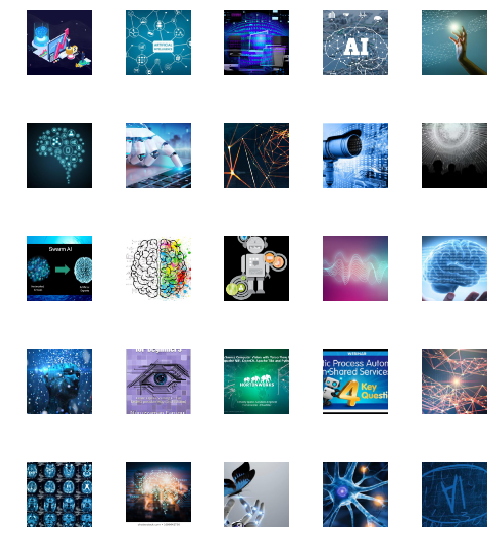

In [7]:
data.show_batch(rows=5, figsize=(7,8))

In [8]:
generator = basic_generator(in_size=64, n_channels=3, n_extra_layers=1)
critic = basic_critic(in_size=64, n_channels=3, n_extra_layers=1)

In [9]:
learn = GANLearner.wgan(data, generator, critic, switch_eval=False,
                       opt_func = partial(optim.Adam, betas = (0.,0.99)), wd=0.)

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,-0.484745,#na#,0.440664,-0.674650,00:46
1,-0.804672,#na#,0.566265,-1.082744,00:32
2,-0.969665,#na#,0.634704,-1.297033,00:33
3,-1.054617,#na#,0.674670,-1.411910,00:30
4,-1.099415,#na#,0.700270,-1.475870,00:29
5,-1.124050,#na#,0.717992,-1.513153,00:32
6,-1.138383,#na#,0.731116,-1.535998,00:31
7,-1.147755,#na#,0.741281,-1.551174,00:34
8,-1.153809,#na#,0.749326,-1.561181,00:33
9,-1.158828,#na#,0.755989,-1.569061,00:36


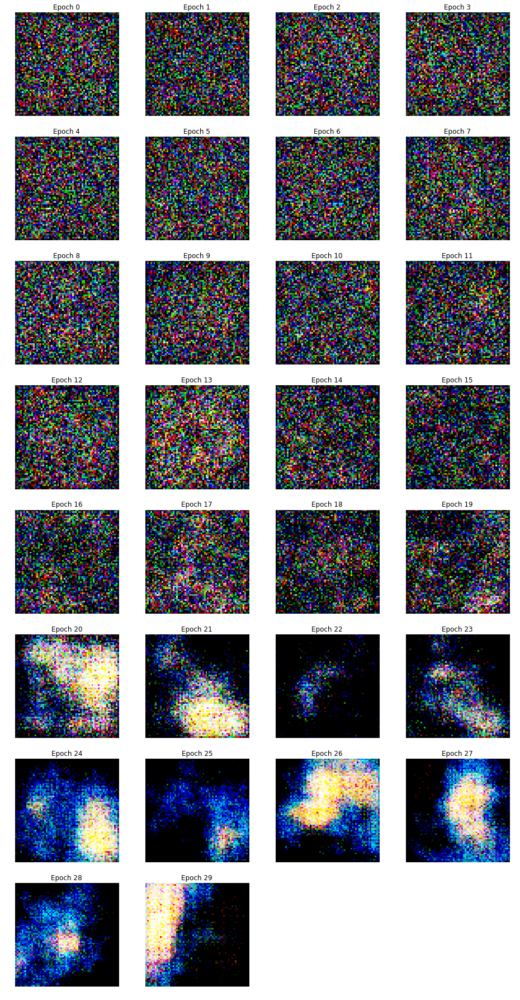

In [10]:
learn.fit(30,2e-4)

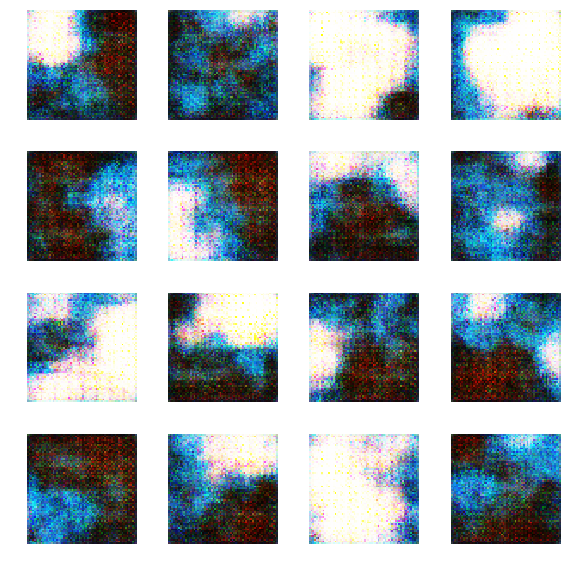

In [12]:
learn.gan_trainer.switch(gen_mode=True)
learn.show_results(ds_type=DatasetType.Train, rows=4, figsize=(8,8))

In [13]:
learn.gan_trainer.switch(gen_mode=False)

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,-0.508646,#na#,0.290703,-0.681101,00:37
1,-0.503369,#na#,0.456713,-0.715944,00:32
2,-0.499412,#na#,0.430298,-0.698703,00:30
3,-0.539898,#na#,0.450679,-0.751490,00:33
4,-0.620666,#na#,0.469803,-0.850345,00:30
5,-0.690652,#na#,0.483779,-0.931734,00:31
6,-0.642892,#na#,0.480196,-0.880047,00:34
7,-0.613042,#na#,0.487560,-0.853054,00:35
8,-0.595801,#na#,0.474059,-0.826603,00:33
9,-0.618510,#na#,0.488818,-0.858468,00:33


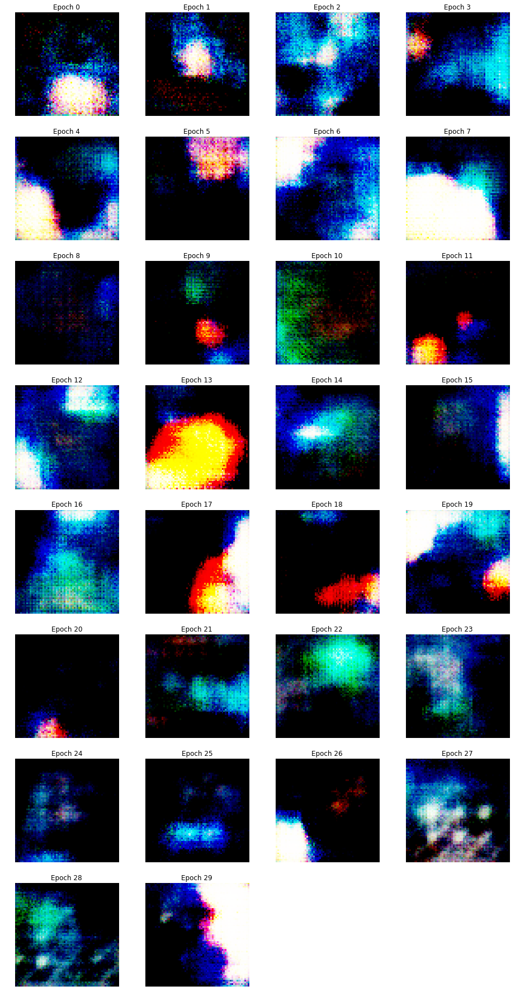

In [14]:
learn.fit(30,2e-4)

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,-0.727407,#na#,0.204558,-0.922966,00:32
1,-0.724911,#na#,0.390768,-0.970734,00:32
2,-0.738992,#na#,0.403789,-0.985136,00:31
3,-0.752127,#na#,0.448094,-1.011243,00:34
4,-0.715507,#na#,0.444255,-0.970205,00:35
5,-0.723425,#na#,0.437267,-0.974066,00:34
6,-0.813707,#na#,0.454753,-1.079240,00:30
7,-0.891810,#na#,0.495369,-1.186422,00:31
8,-0.736953,#na#,0.466020,-1.002394,00:30
9,-0.654734,#na#,0.425591,-0.885904,00:34


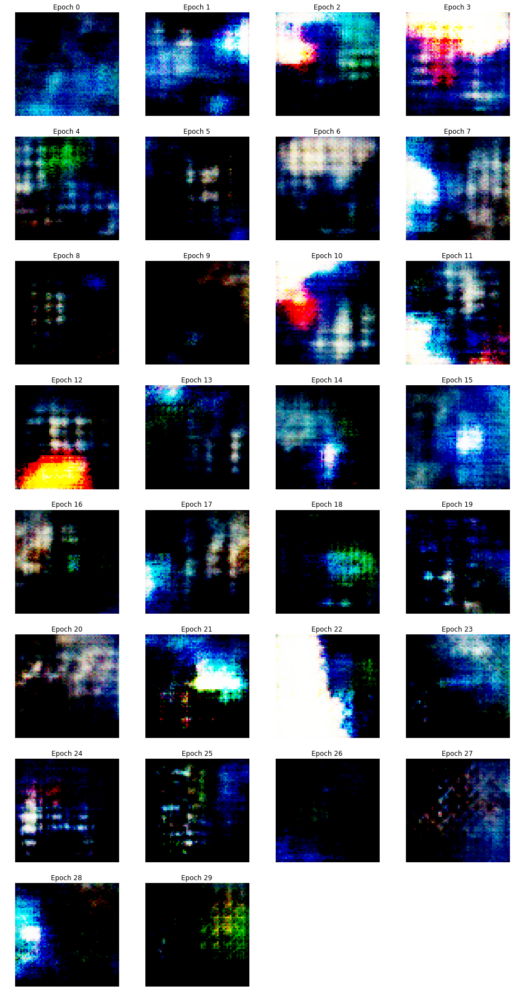

In [15]:
learn.fit(30,2e-4)

In [16]:
learn.save('stage-1')

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,-0.564361,#na#,0.514976,-0.792929,00:34
1,-0.749136,#na#,0.571373,-1.020797,00:35
2,-0.810334,#na#,0.614468,-1.111718,00:36
3,-0.709514,#na#,0.580978,-0.988057,00:33
4,-0.756937,#na#,0.555868,-1.029223,00:34
5,-0.718365,#na#,0.541396,-0.984349,00:34
6,-0.877859,#na#,0.573780,-1.172165,00:34
7,-0.774490,#na#,0.537523,-1.045316,00:35
8,-0.817120,#na#,0.559022,-1.102993,00:34
9,-0.849001,#na#,0.571666,-1.149989,00:34


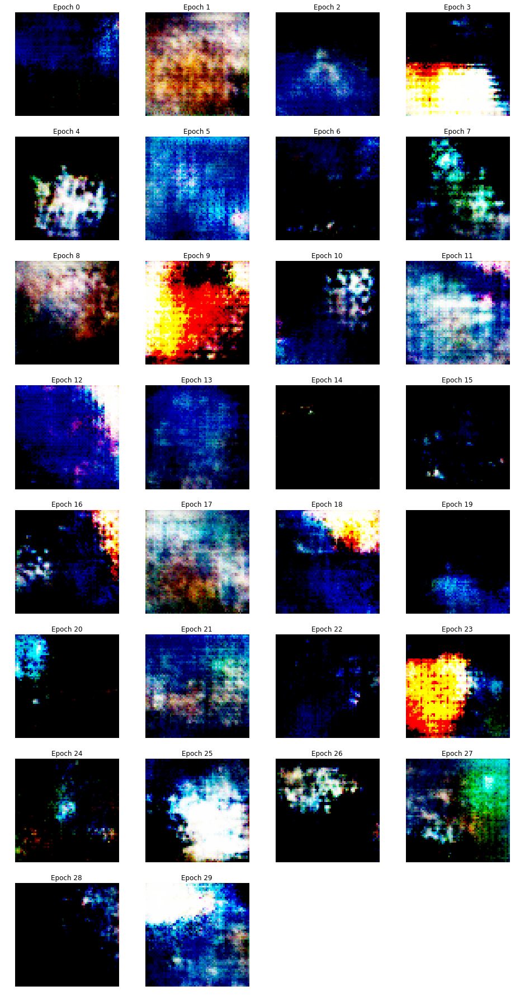

In [17]:
learn.fit(30,2e-4)

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,-0.503189,#na#,0.258699,-0.672110,00:32
1,-0.604111,#na#,0.416245,-0.822820,00:35
2,-0.753537,#na#,0.487748,-1.014675,00:34
3,-0.718095,#na#,0.459927,-0.968308,00:34
4,-0.819989,#na#,0.477174,-1.082526,00:35
5,-0.715822,#na#,0.507957,-0.986979,00:34
6,-0.803118,#na#,0.492231,-1.064366,00:33
7,-0.619885,#na#,0.484705,-0.871533,00:34
8,-0.758613,#na#,0.519551,-1.028245,00:34
9,-0.638876,#na#,0.444534,-0.859551,00:34


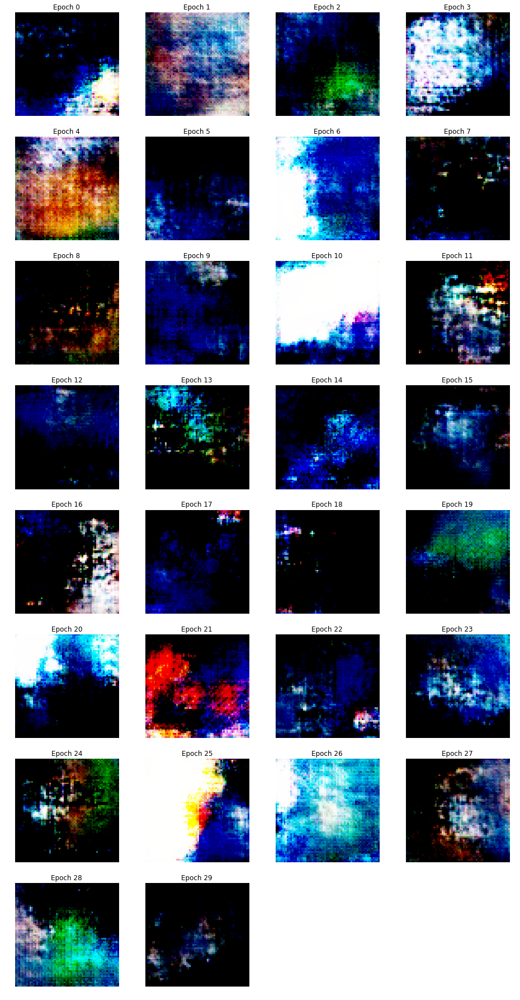

In [18]:
learn.save('stage-2')
learn.fit(30,2e-4)

epoch,train_loss,valid_loss,gen_loss,disc_loss,time
0,-0.469974,#na#,0.516859,-0.669876,00:35
1,-0.628415,#na#,0.463875,-0.845705,00:35
2,-0.578575,#na#,0.440052,-0.789241,00:34
3,-0.570409,#na#,0.449231,-0.787012,00:34
4,-0.548327,#na#,0.473172,-0.769956,00:33
5,-0.659166,#na#,0.500548,-0.897027,00:35
6,-0.606989,#na#,0.456030,-0.827117,00:34
7,-0.548629,#na#,0.458889,-0.768162,00:34
8,-0.679847,#na#,0.477736,-0.914632,00:34
9,-0.585906,#na#,0.447944,-0.798457,00:34


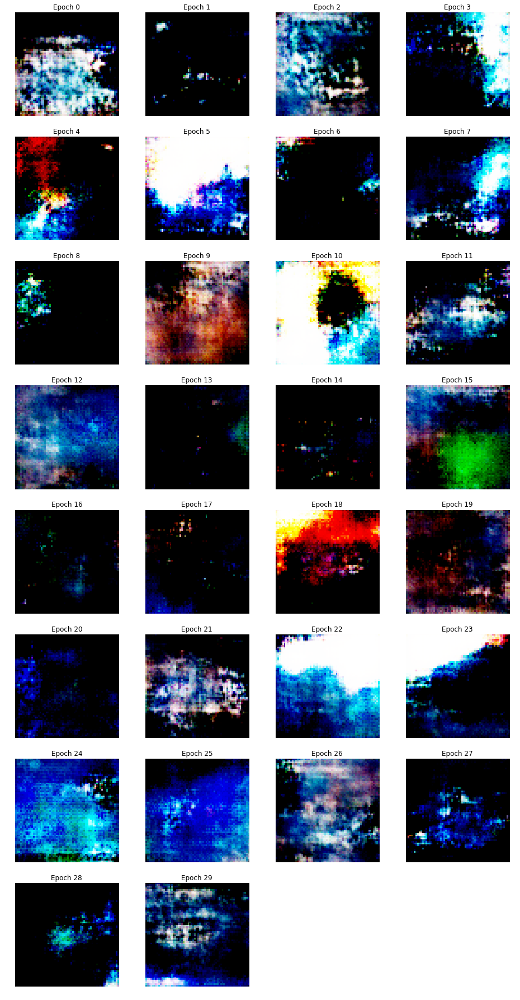

In [19]:
learn.save('stage-3')
learn.fit(30,2e-4)

In [20]:
learn.save('stage-4')

## WGAN from scratch

In [3]:
import sys
sys.path.insert(0, "fastaiv7")
from fastai.conv_learner import *
from fastai.dataset import *
from fastai. imports import *
from fastai.transforms import *
from fastai.conv_learner import *
from fastai.model import *
from fastai.dataset import *
from fastai.sgdr import *
from fastai.plots import *

In [115]:
path = Path('data/AI_GAN')

### Load the same images 16 times

In [116]:
CSV_PATH = path/'files.csv'

In [117]:
files = path.glob('img/*')

with CSV_PATH.open('w') as fo:
    for f in files: fo.write(f'{f.relative_to(path)},0\n')

In [118]:
csv_path_df = pd.read_csv('data/AI_GAN/files.csv', names=['filename', '0'])
csv_path_df.shape

(4682, 2)

In [119]:
csv_path_df['invalid_filename'] = csv_path_df.apply(lambda x: 1 if 'gif' in x['filename'] else 0, axis=1)

In [120]:
csv_path_df['invalid_filename'].value_counts()

0    4638
1      44
Name: invalid_filename, dtype: int64

In [121]:
# 2**4 = 16
for _ in range(4):
    csv_path_df = pd.concat([csv_path_df, csv_path_df])

In [122]:
csv_path_df['invalid_filename'].value_counts()

0    74208
1      704
Name: invalid_filename, dtype: int64

In [123]:
csv_path_df[csv_path_df.invalid_filename == 0]\
[['filename', '0']]\
.to_csv('data/AI_GAN/files.csv', header=False, index=False)

In [124]:
class ConvBlock(nn.Module):
    def __init__(self, ni, no, ks, stride, bn=True, pad=None):
        super().__init__()
        if pad is None: pad = ks//2//stride
        self.conv = nn.Conv2d(ni, no, ks, stride, padding=pad, bias=False)
        self.bn = nn.BatchNorm2d(no) if bn else None
        self.relu = nn.LeakyReLU(0.2, inplace=True)
    
    def forward(self, x):
        x = self.relu(self.conv(x))
        return self.bn(x) if self.bn else x

In [125]:
class DCGAN_D(nn.Module):
    def __init__(self, isize, nc, ndf, n_extra_layers=0):
        super().__init__()
        assert isize % 16 == 0, "isize has to be a multiple of 16"

        self.initial = ConvBlock(nc, ndf, 4, 2, bn=False)
        csize,cndf = isize/2,ndf
        self.extra = nn.Sequential(*[ConvBlock(cndf, cndf, 3, 1)
                                    for t in range(n_extra_layers)])

        pyr_layers = []
        while csize > 4:
            pyr_layers.append(ConvBlock(cndf, cndf*2, 4, 2))
            cndf *= 2; csize /= 2
        self.pyramid = nn.Sequential(*pyr_layers)
        
        self.final = nn.Conv2d(cndf, 1, 4, padding=0, bias=False)

    def forward(self, input):
        x = self.initial(input)
        x = self.extra(x)
        x = self.pyramid(x)
        return self.final(x).mean(0).view(1)

In [126]:
class DeconvBlock(nn.Module):
    def __init__(self, ni, no, ks, stride, pad, bn=True):
        super().__init__()
        self.conv = nn.ConvTranspose2d(ni, no, ks, stride, padding=pad, bias=False)
        self.bn = nn.BatchNorm2d(no)
        self.relu = nn.ReLU(inplace=True)
        
    def forward(self, x):
        x = self.relu(self.conv(x))
        return self.bn(x) if self.bn else x

In [127]:
class DCGAN_G(nn.Module):
    def __init__(self, isize, nz, nc, ngf, n_extra_layers=0):
        super().__init__()
        assert isize % 16 == 0, "isize has to be a multiple of 16"

        cngf, tisize = ngf//2, 4
        while tisize!=isize: cngf*=2; tisize*=2
        layers = [DeconvBlock(nz, cngf, 4, 1, 0)]

        csize, cndf = 4, cngf
        while csize < isize//2:
            layers.append(DeconvBlock(cngf, cngf//2, 4, 2, 1))
            cngf //= 2; csize *= 2

        layers += [DeconvBlock(cngf, cngf, 3, 1, 1) for t in range(n_extra_layers)]
        layers.append(nn.ConvTranspose2d(cngf, nc, 4, 2, 1, bias=False))
        self.features = nn.Sequential(*layers)

    def forward(self, input): return F.tanh(self.features(input))

In [140]:
bs,sz,nz = 256*36,64,100

In [141]:
tfms = tfms_from_stats(inception_stats, sz)
md = ImageClassifierData.from_csv(path, '', CSV_PATH, tfms=tfms, bs=bs,
                                  skip_header=False, continuous=True)

In [142]:
x,_ = next(iter(md.val_dl))

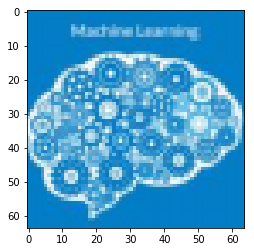

In [143]:
plt.imshow(md.trn_ds.denorm(x)[0]);

In [144]:
netG = DCGAN_G(sz, nz, 3, 64, 1).cuda()
netD = DCGAN_D(sz, 3, 64, 1).cuda()

In [145]:
def create_noise(b): return V(torch.zeros(b, nz, 1, 1).normal_(0, 1))

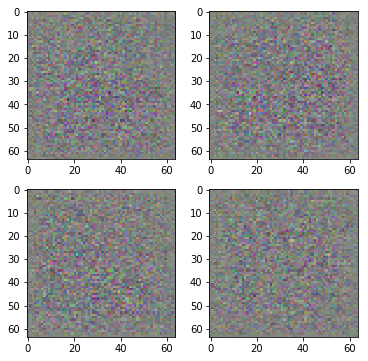

In [146]:
preds = netG(create_noise(4))
pred_ims = md.trn_ds.denorm(preds)

fig, axes = plt.subplots(2, 2, figsize=(6, 6))
for i,ax in enumerate(axes.flat): ax.imshow(pred_ims[i]);

In [147]:
def gallery(x, nc=3):
    n,h,w,c = x.shape
    nr = n//nc
    assert n == nr*nc
    return (x.reshape(nr, nc, h, w, c)
              .swapaxes(1,2)
              .reshape(h*nr, w*nc, c))

In [148]:
def train(niter, first=True):
    gen_iterations = 0
    for epoch in trange(niter):
        netD.train(); netG.train()
        data_iter = iter(md.trn_dl)
        i,n = 0,len(md.trn_dl)
        with tqdm(total=n) as pbar:
            while i < n:
                set_trainable(netD, True)
                set_trainable(netG, False)
                d_iters = 100 if (first and (gen_iterations < 25) or (gen_iterations % 500 == 0)) else 5
                j = 0
                while (j < d_iters) and (i < n):
                    j += 1; i += 1
                    for p in netD.parameters(): p.data.clamp_(-0.01, 0.01)
                    real = V(next(data_iter)[0])
                    real_loss = netD(real)
                    fake = netG(create_noise(real.size(0)))
                    fake_loss = netD(V(fake.data))
                    netD.zero_grad()
                    lossD = real_loss-fake_loss
                    lossD.backward()
                    optimizerD.step()
                    pbar.update()

                set_trainable(netD, False)
                set_trainable(netG, True)
                netG.zero_grad()
                lossG = netD(netG(create_noise(bs)))
                lossG.backward()
                optimizerG.step()
                gen_iterations += 1
            
        print(f'Loss_D {to_np(lossD)}; Loss_G {to_np(lossG)}; '
              f'D_real {to_np(real_loss)}; Loss_D_fake {to_np(fake_loss)}')

In [149]:
torch.backends.cudnn.benchmark=True

In [150]:
optimizerD = optim.RMSprop(netD.parameters(), lr = 1e-4)
optimizerG = optim.RMSprop(netG.parameters(), lr = 1e-4)

In [151]:
train(1, False)

100%|██████████| 16/16 [01:11<00:00,  2.28s/it]
Loss_D [-1.07791]; Loss_G [0.64234]; D_real [-0.49078]; Loss_D_fake [0.58713]
100%|██████████| 1/1 [01:11<00:00, 71.93s/it]

In [152]:
fixed_noise = create_noise(bs)

In [156]:
set_trainable(netD, True)
set_trainable(netG, True)
optimizerD = optim.RMSprop(netD.parameters(), lr = 1e-5)
optimizerG = optim.RMSprop(netG.parameters(), lr = 1e-5)

In [157]:
train(1, False)

100%|██████████| 16/16 [01:04<00:00,  1.59s/it]
Loss_D [-1.03351]; Loss_G [0.52435]; D_real [-0.52014]; Loss_D_fake [0.51336]
100%|██████████| 1/1 [01:05<00:00, 65.33s/it]

In [158]:
set_trainable(netD, True)
set_trainable(netG, True)
optimizerD = optim.RMSprop(netD.parameters(), lr = 2e-4)
optimizerG = optim.RMSprop(netG.parameters(), lr = 2e-4)

In [185]:
train(30, False)

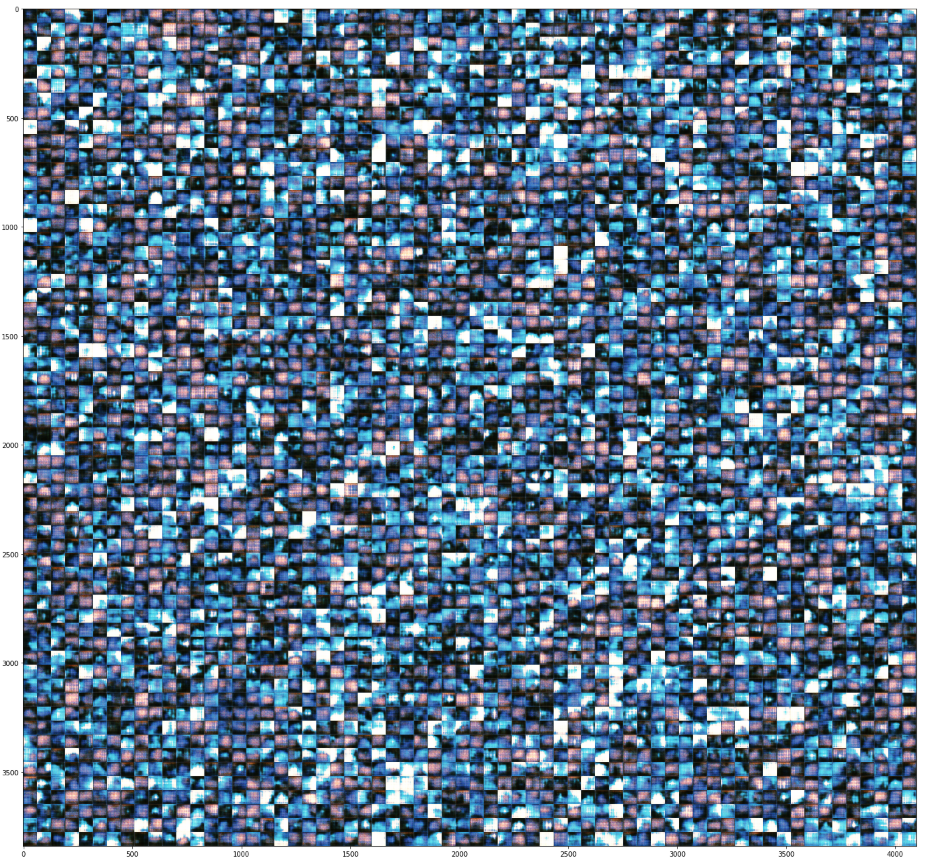

In [187]:
netD.eval(); netG.eval();
fake = netG(fixed_noise).data.cpu()
faked = np.clip(md.trn_ds.denorm(fake),0,1)

plt.figure(figsize=(24,24))
plt.imshow(gallery(faked, 64));

In [162]:
train(100, False)

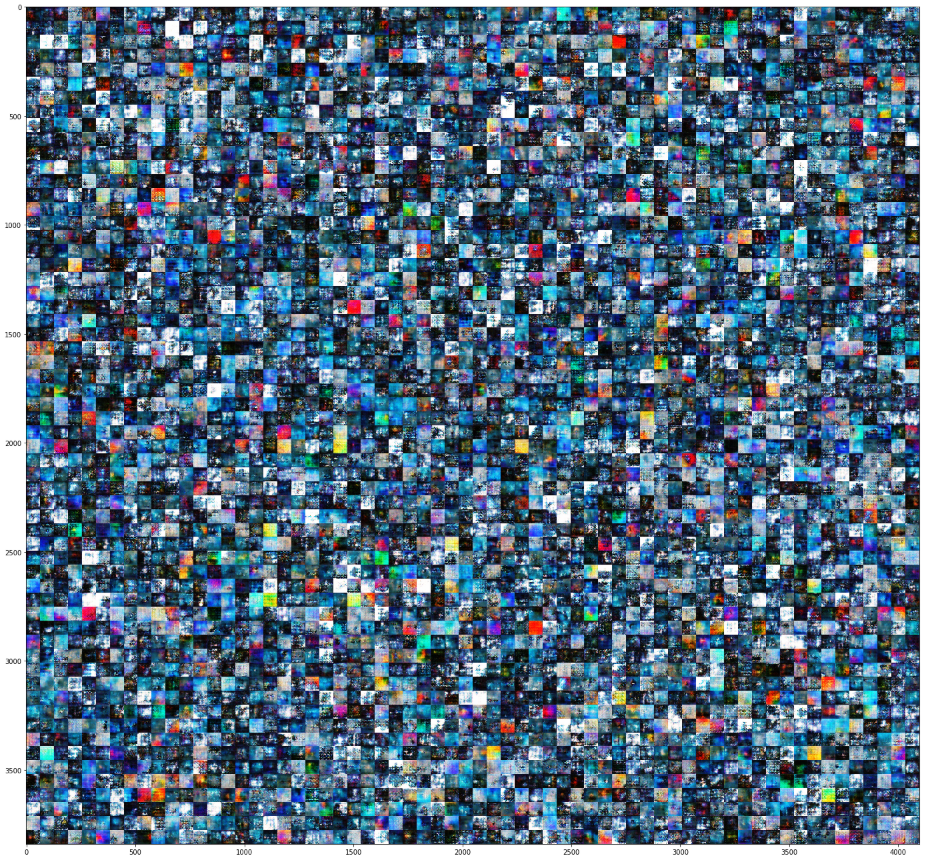

In [188]:
netD.eval(); netG.eval();
fake = netG(fixed_noise).data.cpu()
faked = np.clip(md.trn_ds.denorm(fake),0,1)

plt.figure(figsize=(24,24))
plt.imshow(gallery(faked, 64));

In [164]:
train(100, False)

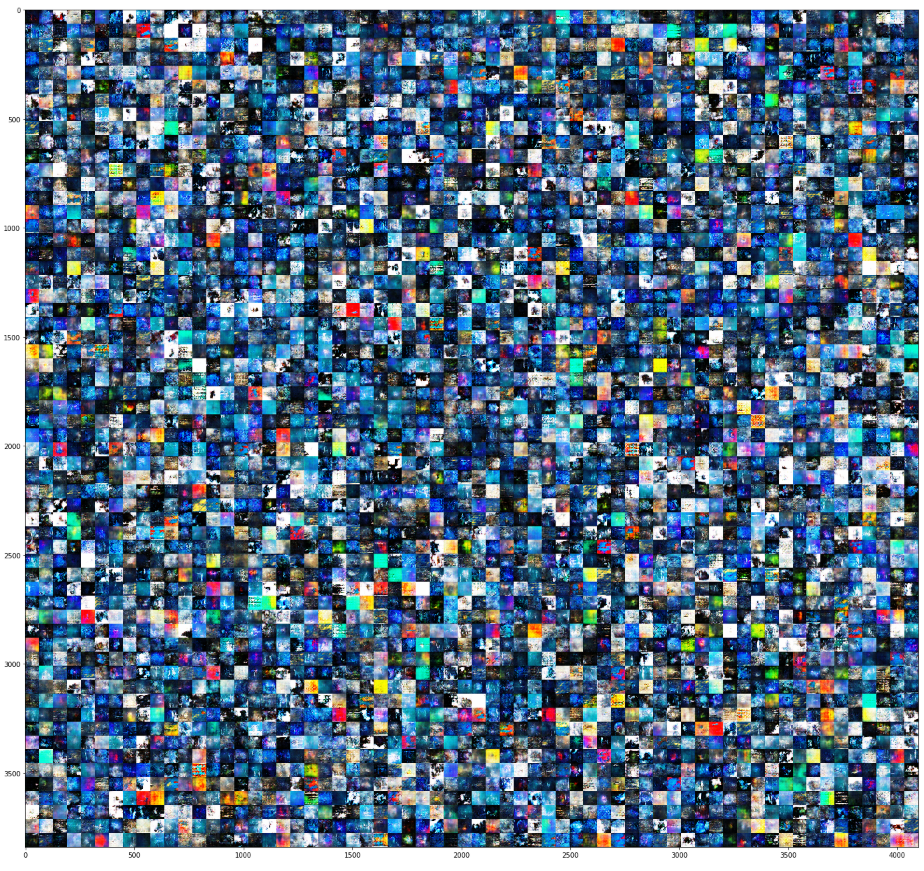

In [189]:
netD.eval(); netG.eval();
fake = netG(fixed_noise).data.cpu()
faked = np.clip(md.trn_ds.denorm(fake),0,1)

plt.figure(figsize=(24,24))
plt.imshow(gallery(faked, 64));

In [167]:
train(100, False)

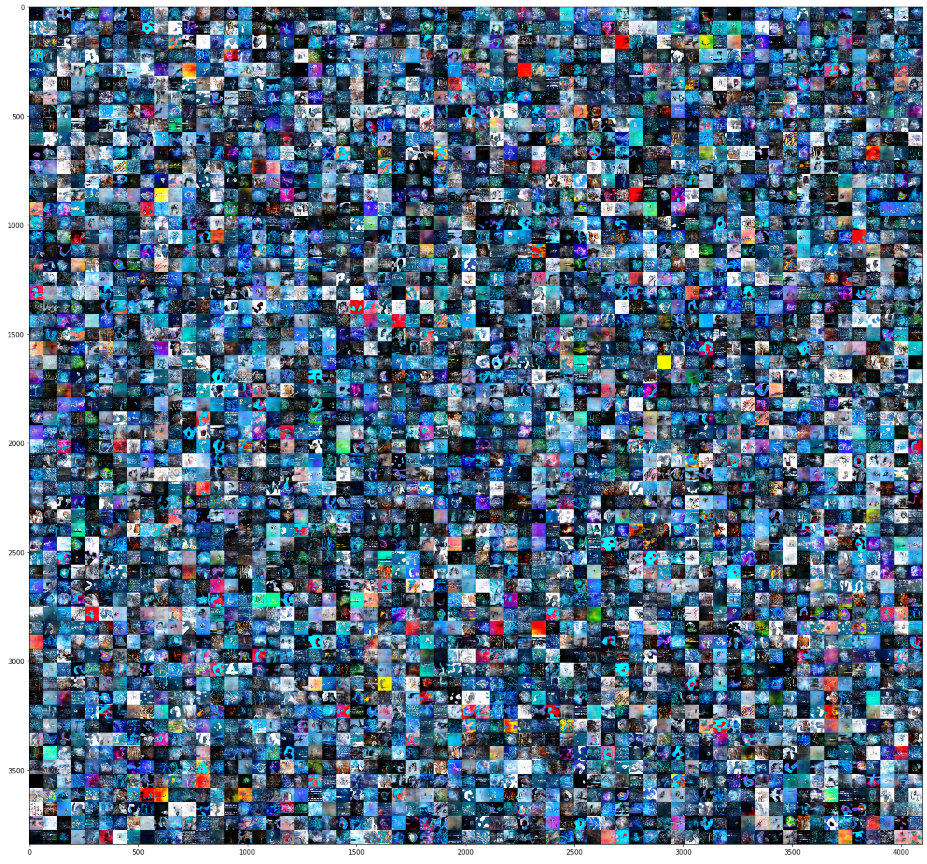

In [190]:
netD.eval(); netG.eval();
fake = netG(fixed_noise).data.cpu()
faked = np.clip(md.trn_ds.denorm(fake),0,1)

plt.figure(figsize=(24,24))
plt.imshow(gallery(faked, 64));

In [191]:
train(100, False)

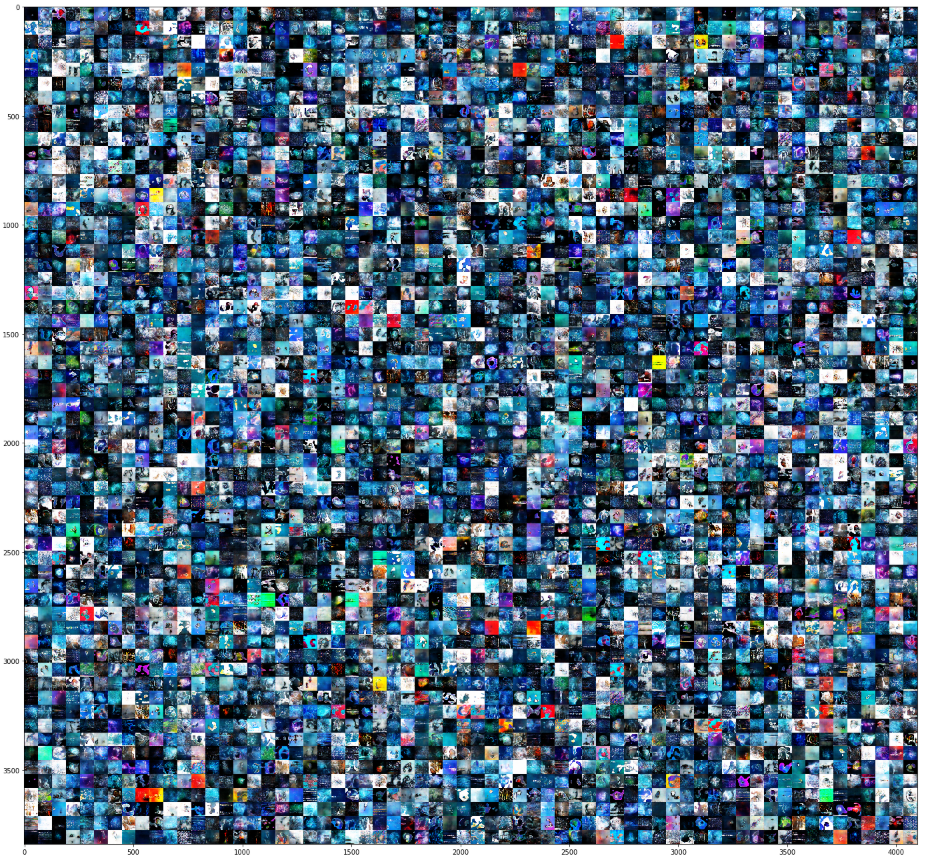

In [192]:
netD.eval(); netG.eval();
fake = netG(fixed_noise).data.cpu()
faked = np.clip(md.trn_ds.denorm(fake),0,1)

plt.figure(figsize=(24,24))
plt.imshow(gallery(faked, 64));

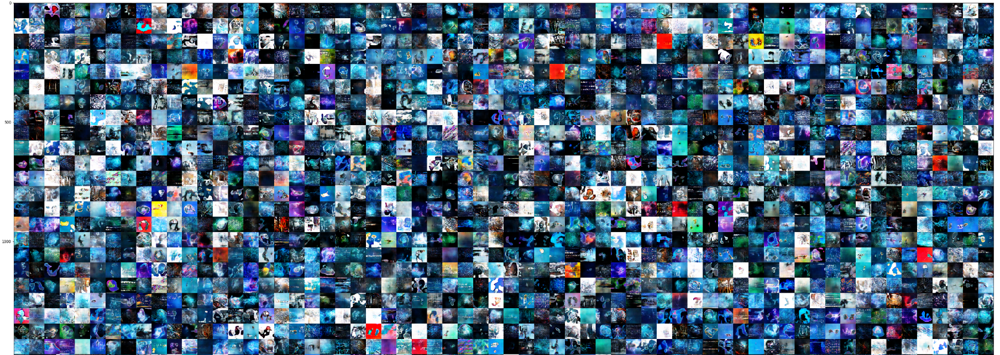

In [193]:
netD.eval(); netG.eval();
fake = netG(fixed_noise).data.cpu()
faked = np.clip(md.trn_ds.denorm(fake),0,1)

plt.figure(figsize=(48,48))
plt.imshow(gallery(faked, 64));

In [177]:
torch.save(netD.state_dict(), 'model/ai_logo_discriminator_1.h5')
torch.save(netG.state_dict(), 'model/ai_logo_generator_1.h5')

In [ ]:
train(100, False)

  0%|          | 0/16 [00:00<?, ?it/s]

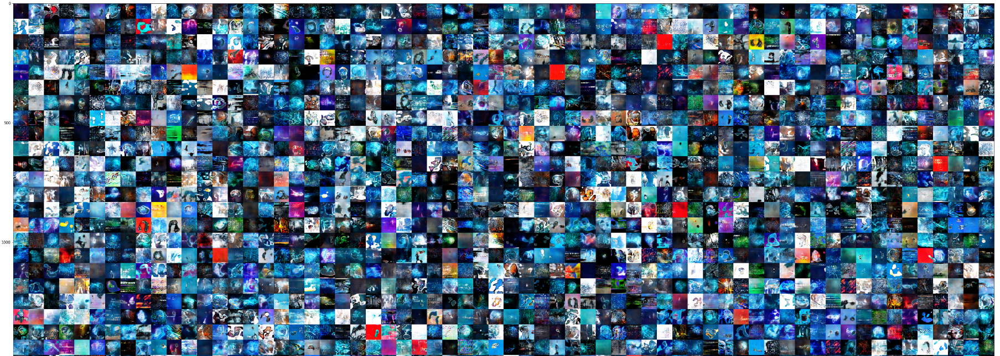

In [194]:
netD.eval(); netG.eval();
fake = netG(fixed_noise).data.cpu()
faked = np.clip(md.trn_ds.denorm(fake),0,1)

plt.figure(figsize=(48,48))
plt.imshow(gallery(faked, 64));

In [180]:
torch.save(netD.state_dict(), 'model/ai_logo_discriminator_2.h5')
torch.save(netG.state_dict(), 'model/ai_logo_generator_2.h5')

In [195]:
train(100, False)

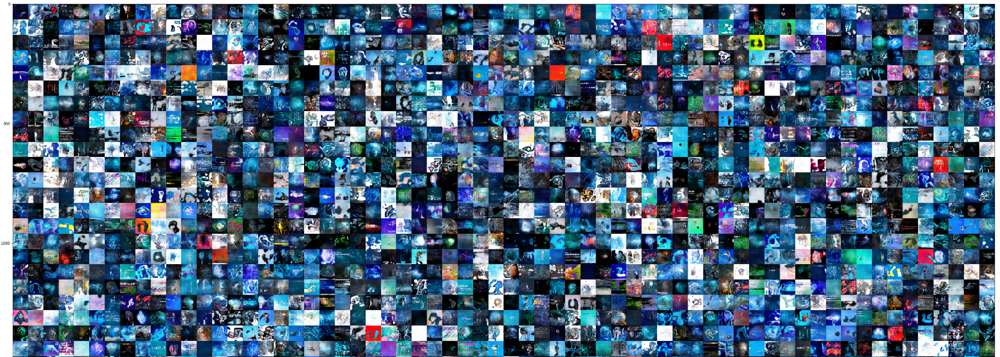

In [196]:
netD.eval(); netG.eval();
fake = netG(fixed_noise).data.cpu()
faked = np.clip(md.trn_ds.denorm(fake),0,1)

plt.figure(figsize=(48,48))
plt.imshow(gallery(faked, 64));

In [ ]:
torch.save(netD.state_dict(), 'model/ai_logo_discriminator_3.h5')
torch.save(netG.state_dict(), 'model/ai_logo_generator_3.h5')

In [189]:
netD

DCGAN_D(
  (initial): ConvBlock(
    (conv): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (relu): LeakyReLU(0.2, inplace)
  )
  (extra): Sequential(
    (0): ConvBlock(
      (conv): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
      (relu): LeakyReLU(0.2, inplace)
    )
  )
  (pyramid): Sequential(
    (0): ConvBlock(
      (conv): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True)
      (relu): LeakyReLU(0.2, inplace)
    )
    (1): ConvBlock(
      (conv): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True)
      (relu): LeakyReLU(0.2, inplace)
    )
    (2): ConvBlock(
      (conv): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
 

In [190]:
netG

DCGAN_G(
  (features): Sequential(
    (0): DeconvBlock(
      (conv): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True)
      (relu): ReLU(inplace)
    )
    (1): DeconvBlock(
      (conv): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True)
      (relu): ReLU(inplace)
    )
    (2): DeconvBlock(
      (conv): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True)
      (relu): ReLU(inplace)
    )
    (3): DeconvBlock(
      (conv): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
      (relu): ReLU(inplace)
    )
    (4): DeconvBlock(
      (conv): ConvTranspose2d(64, 64, kernel_size=(3, 3),

In [192]:
denormalizer = md.trn_ds.denorm

In [218]:
def generate_good_image(fake_score:float=-0.1):
    for _ in range(1000):
        fake = netG(create_noise(1))
        fake_score = netD(fake).data.cpu().numpy()

        if fake_score < -0.1:
            pred_img = denormalizer(fake)

            plt.imshow(pred_img[0]);

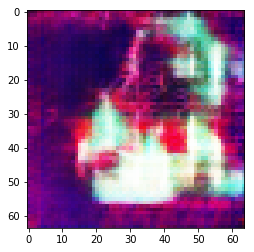

In [201]:
generate_good_image()

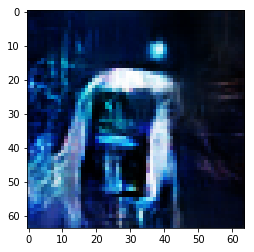

In [203]:
generate_good_image()

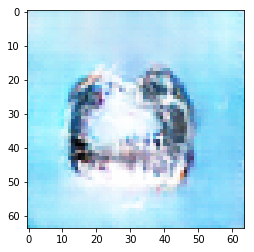

In [204]:
generate_good_image()

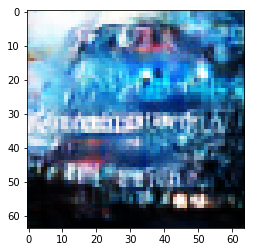

In [206]:
generate_good_image()

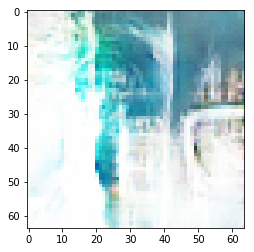

In [210]:
generate_good_image()

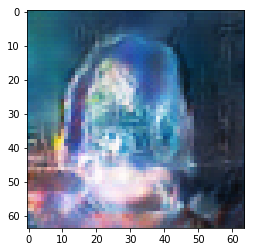

In [212]:
generate_good_image()

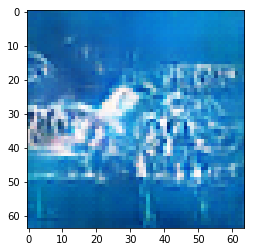

In [214]:
generate_good_image()

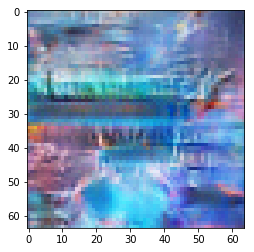

In [222]:
generate_good_image(-0.5)

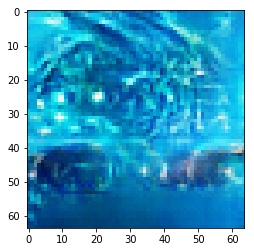

In [223]:
generate_good_image(-0.5)

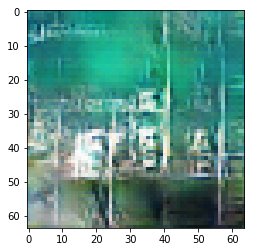

In [247]:
generate_good_image(-0.5)

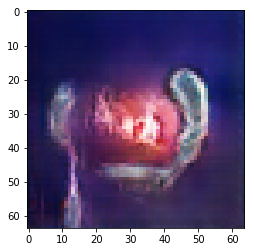

In [250]:
generate_good_image(-0.5)

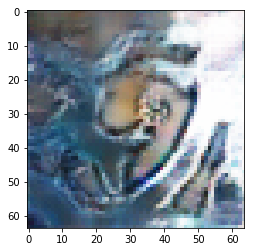

In [254]:
generate_good_image(-0.5)

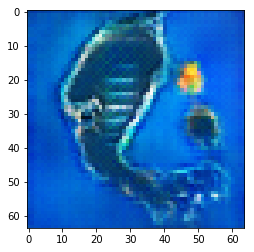

In [257]:
generate_good_image(-0.5)

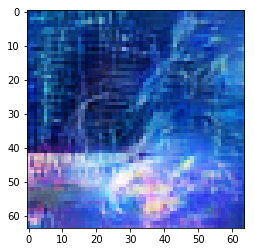

In [268]:
generate_good_image()

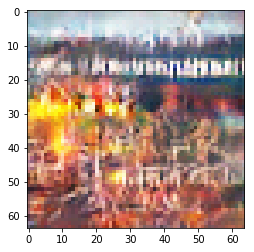

In [272]:
generate_good_image()

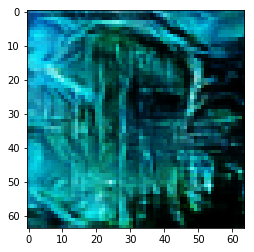

In [273]:
generate_good_image()

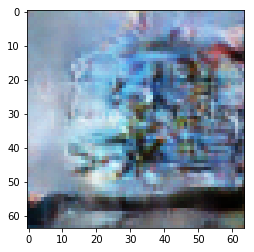

In [278]:
generate_good_image()

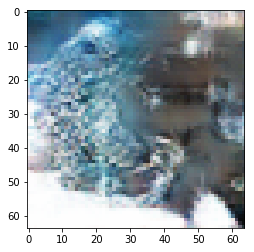

In [279]:
generate_good_image()

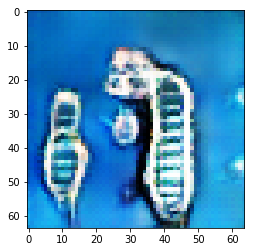

In [280]:
generate_good_image()

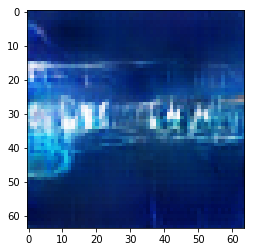

In [281]:
generate_good_image()

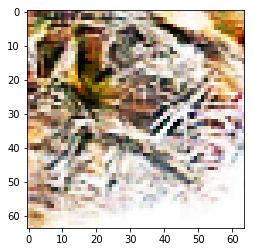

In [283]:
generate_good_image()

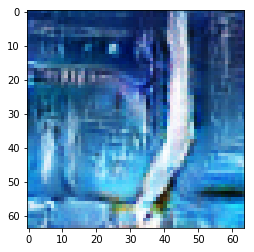

In [284]:
generate_good_image()

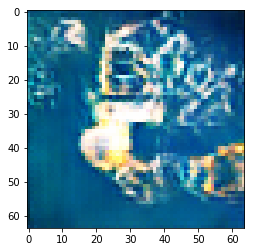

In [293]:
generate_good_image()

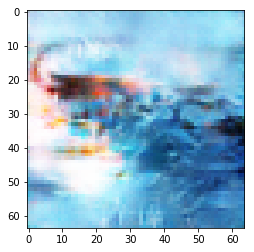

In [294]:
generate_good_image()

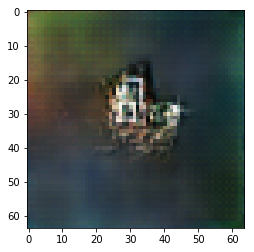

In [296]:
generate_good_image()

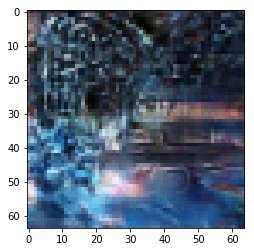

In [302]:
generate_good_image()

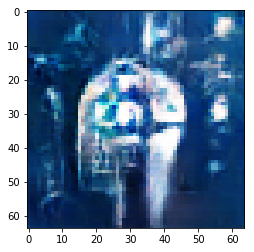

In [305]:
generate_good_image()

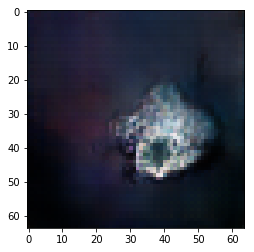

In [313]:
generate_good_image()

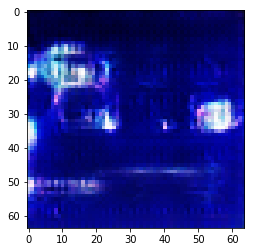

In [316]:
generate_good_image()

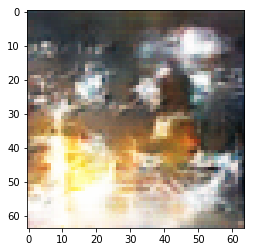

In [317]:
generate_good_image()

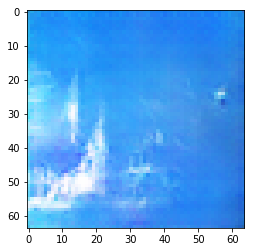

In [318]:
generate_good_image()

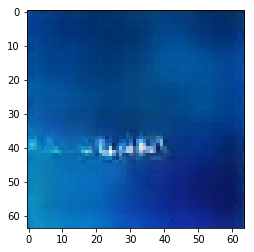

In [321]:
generate_good_image()

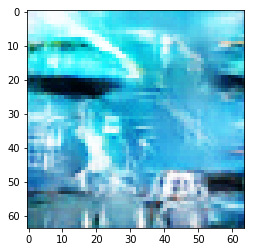

In [324]:
generate_good_image()

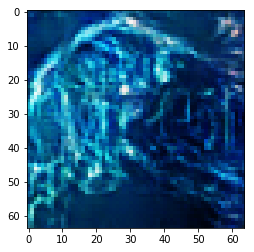

In [329]:
generate_good_image()